# Training a Crypto Trading Agent

This notebook demonstrates how to train a reinforcement learning agent for cryptocurrency trading using the rl-agent library.

In [6]:
%load_ext autoreload
%autoreload 2

import sys
sys.path.append('../')

from rl_agent.trading_env import CryptoTradingEnv
from rl_agent.data_processing import download_data, add_technical_indicators
from stable_baselines3 import PPO
import pandas as pd
import matplotlib.pyplot as plt

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## 1. Download and Preprocess Data

In [7]:
# Download data
start_date = '2022-01-01'
end_date = '2023-01-01'
symbol = ['BTC/USD']

df = download_data(symbol, start_date, end_date)

# Preprocess data
df = add_technical_indicators(df, INDICATORS=['macd', 'rsi', 'cci', 'adx'])
df.dropna(inplace=True)

print(df.head())

       tic                 timestamp      open      high       low     close  \
1  BTC/USD 2022-01-02 01:00:00-05:00  47087.56  47992.00  46668.46  47098.88   
2  BTC/USD 2022-01-03 01:00:00-05:00  47102.58  47568.95  45700.83  46154.60   
3  BTC/USD 2022-01-04 01:00:00-05:00  46153.00  47527.78  45547.55  46314.83   
4  BTC/USD 2022-01-05 01:00:00-05:00  46303.77  47066.70  42460.00  43051.65   
5  BTC/USD 2022-01-06 01:00:00-05:00  43061.81  43588.75  40957.53  41846.64   

        volume  trade_count          vwap        macd         rsi         cci  \
1   443.889422      22218.0  47195.450479    0.072019  100.000000  -66.666667   
2   783.384691      29891.0  46514.267285  -29.190300    0.314667 -100.000000   
3   850.111475      29224.0  46453.886975  -35.998952   15.675440  -67.634862   
4  1882.128273      58070.0  44573.054825 -168.790246    3.579205 -166.666667   
5  1166.578757      40734.0  42496.153736 -296.970060    2.738746 -141.794303   

     adx  
1  100.0  
2  100.0  

In [8]:
print(df.tail())
print(df.shape)

         tic                 timestamp      open      high       low  \
360  BTC/USD 2022-12-27 01:00:00-05:00  16872.72  16890.00  16562.85   
361  BTC/USD 2022-12-28 01:00:00-05:00  16597.10  16775.10  16465.58   
362  BTC/USD 2022-12-29 01:00:00-05:00  16573.15  16655.05  16512.71   
363  BTC/USD 2022-12-30 01:00:00-05:00  16547.40  16641.27  16355.00   
364  BTC/USD 2022-12-31 01:00:00-05:00  16534.08  16632.33  16466.86   

        close       volume  trade_count          vwap        macd        rsi  \
360  16599.15  4078.846778      70487.0  16722.269632 -114.237520  41.411660   
361  16573.15  4341.727684      72551.0  16595.337061 -127.696407  40.922664   
362  16550.57  3029.561521      60558.0  16600.517317 -138.587143  40.475660   
363  16532.87  4021.301107      68911.0  16518.229520 -146.952395  40.105842   
364  16522.29  2451.303966      46865.0  16546.411935 -152.675686  39.871336   

            cci        adx  
360  -73.191056  21.999819  
361 -127.001959  26.950871  

## 2. Create the Trading Environment

In [9]:
env = CryptoTradingEnv(
    df=df,
    crypto_dim=1,
    hmax=100,
    initial_amount=10000,
    buy_cost_pct=0.001,
    sell_cost_pct=0.001,
    reward_scaling=1e-4,
    state_space=10,
    action_space=3,
    tech_indicator_list=['macd', 'rsi', 'cci', 'adx'],
)

DataFrame shape: (364, 13)
Columns: Index(['tic', 'timestamp', 'open', 'high', 'low', 'close', 'volume',
       'trade_count', 'vwap', 'macd', 'rsi', 'cci', 'adx'],
      dtype='object')
State space: 10
Crypto dim: 1
Tech indicators: ['macd', 'rsi', 'cci', 'adx']
Initiated state: [10000, 47098.88, 0, 0.07201923076354433, 100.0, -66.66666666666667, 100.0]
Initiated state length: 7
Final initiated state: [10000, 47098.88, 0, 0.07201923076354433, 100.0, -66.66666666666667, 100.0, 0, 0, 0]
Final initiated state length: 10


## 3. Train the Agent

In [10]:
model = PPO('MlpPolicy', env, verbose=1)
model.learn(total_timesteps=100000)

Using cuda device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Initiated state: [10000, 47098.88, 0, 0.07201923076354433, 100.0, -66.66666666666667, 100.0]
Initiated state length: 7
Final initiated state: [10000, 47098.88, 0, 0.07201923076354433, 100.0, -66.66666666666667, 100.0, 0, 0, 0]
Final initiated state length: 10


/home/rcgalbo/rl-agent/rla/lib/python3.10/site-packages/stable_baselines3/common/vec_env/patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(


Updated state: [9992.79087500057, 46154.6, 0.0, -29.19029950247932, 0.31466672699089315, -99.9999999999993, 100.0]
Updated state length: 7
Final updated state: [9992.79087500057, 46154.6, 0.0, -29.19029950247932, 0.31466672699089315, -99.9999999999993, 100.0, 0, 0, 0]
Final updated state length: 10
Updated state: [-9.992790874999628, 46314.83, 0.21650693267844529, -35.99895245837979, 15.675439839930775, -67.63486152224726, 100.0]
Updated state length: 7
Final updated state: [-9.992790874999628, 46314.83, 0.21650693267844529, -35.99895245837979, 15.675439839930775, -67.63486152224726, 100.0, 0, 0, 0]
Final updated state length: 10
Updated state: [10007.461508167815, 43051.65, 0.0, -168.79024623117584, 3.579204655504512, -166.66666666666666, 100.0]
Updated state length: 7
Final updated state: [10007.461508167815, 43051.65, 0.0, -168.79024623117584, 3.579204655504512, -166.66666666666666, 100.0, 0, 0, 0]
Final updated state length: 10
Updated state: [-10.00746150816667, 41846.64, 0.232452

## 4. Save the Trained Model

In [11]:
model_path = '../models/ppo_crypto_trader.zip'
model.save(model_path)
print(f'Model saved to {model_path}')

Model saved to ../models/ppo_crypto_trader.zip


/home/rcgalbo/rl-agent/rla/lib/python3.10/site-packages/stable_baselines3/common/save_util.py:284: UserWarning: Path '../models' does not exist. Will create it.
  warnings.warn(f"Path '{path.parent}' does not exist. Will create it.")


## 5. Evaluate the Model

In [14]:
# Function to run a single episode
def run_episode(env, model):
    obs = env.reset()
    done = False
    total_reward = 0
    while not done:
        action, _states = model.predict(obs)
        obs, reward, done, info = env.step(action)
        total_reward += reward
    return total_reward

# Run multiple episodes and calculate average reward
num_episodes = 10
rewards = [run_episode(env, model) for _ in range(num_episodes)]
avg_reward = sum(rewards) / num_episodes

print(f'Average reward over {num_episodes} episodes: {avg_reward}')

# Plot rewards

Initiated state: [10000, 16522.29, 0, -152.67568572640448, 39.87133607663485, -109.67913965016461, 39.72531523759955]
Initiated state length: 7
Final initiated state: [10000, 16522.29, 0, -152.67568572640448, 39.87133607663485, -109.67913965016461, 39.72531523759955, 0, 0, 0]
Final initiated state length: 10
Updated state: [-9.999999999998181, 46154.6, 0.6052429778196605, -29.19029950247932, 0.31466672699089315, -99.9999999999993, 100.0]
Updated state length: 7
Final updated state: [-9.999999999998181, 46154.6, 0.6052429778196605, -29.19029950247932, 0.31466672699089315, -99.9999999999993, 100.0, 0, 0, 0]
Final updated state length: 10
Updated state: [-9.999999999994388e-06, 46314.83, 0.6052431944827884, -35.99895245837979, 15.675439839930775, -67.63486152224726, 100.0]
Updated state length: 7
Final updated state: [-9.999999999994388e-06, 46314.83, 0.6052431944827884, -35.99895245837979, 15.675439839930775, -67.63486152224726, 100.0, 0, 0, 0]
Final updated state length: 10
Updated stat

/tmp/ipykernel_273220/332744441.py:25: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  plt.show()


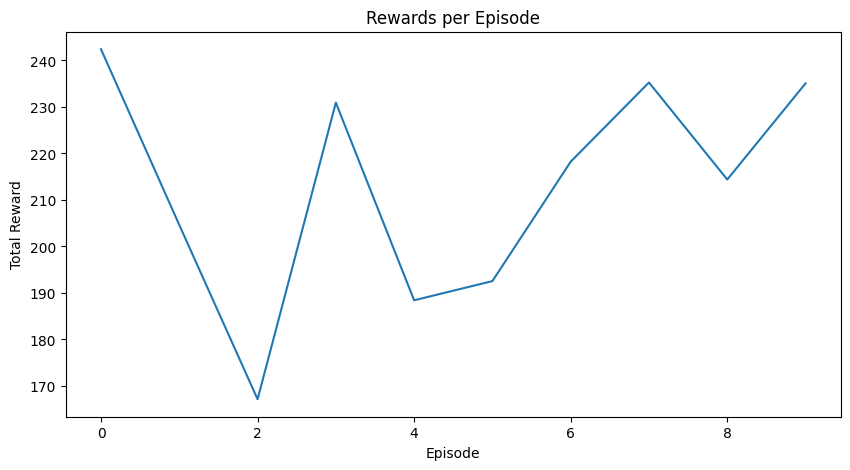

In [21]:
%matplotlib inline

plt.figure(figsize=(10, 5))
plt.plot(rewards)
plt.title('Rewards per Episode')
plt.xlabel('Episode')
plt.ylabel('Total Reward')
plt.show()  # Add this line to display the plot
plt.close()  # Add this line to close the figure and prevent duplication